In [ ]:
!pip install vehicle-makes

In [ ]:
!pip install plotly_express

In [78]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import copy
import re
from datetime import datetime
import plotly_express as px
import plotly.graph_objects as go
%matplotlib inline

# Data Cleaning

### Assumption: Year field is the model year of the car

In [5]:
df = pd.read_csv("vehicles.csv")

In [6]:
df.shape

(10795, 26)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10795 entries, 0 to 10794
Data columns (total 26 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    10795 non-null  int64  
 1   id            10795 non-null  int64  
 2   url           10795 non-null  object 
 3   region        10795 non-null  object 
 4   region_url    10795 non-null  object 
 5   price         10795 non-null  int64  
 6   year          10774 non-null  float64
 7   manufacturer  10375 non-null  object 
 8   model         10630 non-null  object 
 9   condition     6135 non-null   object 
 10  cylinders     6408 non-null   object 
 11  fuel          10719 non-null  object 
 12  odometer      8812 non-null   float64
 13  title_status  10741 non-null  object 
 14  transmission  10717 non-null  object 
 15  vin           6305 non-null   object 
 16  drive         7655 non-null   object 
 17  size          3342 non-null   object 
 18  type          7841 non-nul

In [8]:
df.describe()

,Unnamed: 0,id,price,year,odometer,county,lat,long
count,10795.000000,1.079500e+04,1.079500e+04,10774.000000,8.812000e+03,0.0,10617.000000,10617.000000
mean,268445.772950,7.087607e+09,3.190245e+05,2009.868294,1.004976e+05,NaN,38.381516,-94.177837
std,156144.168607,5.196087e+06,3.051632e+07,8.676451,8.426139e+04,NaN,5.904411,17.808196
min,99.000000,7.074434e+09,0.000000e+00,1900.000000,0.000000e+00,NaN,-56.602000,-160.059000
25%,134787.500000,7.084239e+09,4.250000e+03,2007.000000,4.822700e+04,NaN,34.209800,-106.801000
50%,266298.000000,7.088924e+09,9.500000e+03,2012.000000,9.400000e+04,NaN,39.088700,-88.203100
75%,404468.500000,7.092072e+09,1.787250e+04,2015.000000,1.371248e+05,NaN,42.455600,-81.282700
max,539756.000000,7.093534e+09,3.167547e+09,2021.000000,3.000051e+06,NaN,64.822800,79.900600


In [9]:
df.isnull().sum(axis = 0).sort_values(ascending=False)

county          10795
size             7453
condition        4660
vin              4490
cylinders        4387
paint_color      3450
drive            3140
type             2954
odometer         1983
manufacturer      420
lat               178
long              178
model             165
transmission       78
fuel               76
title_status       54
year               21
image_url           0
description         0
state               0
price               0
region_url          0
region              0
url                 0
id                  0
Unnamed: 0          0
dtype: int64

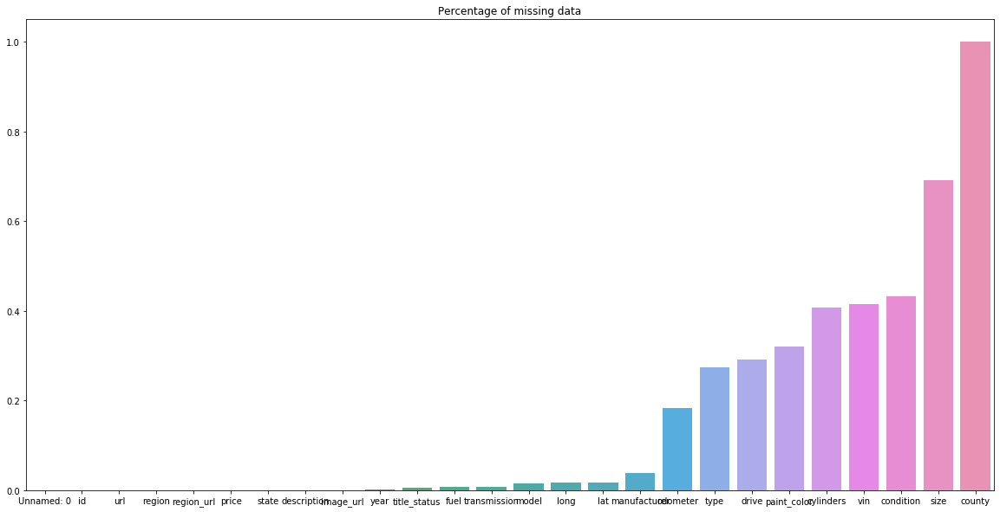

In [10]:
numberOfNulls = df.isnull().sum().sort_values(ascending=True).div(len(df))
plt.figure(figsize=(20,10))
sns.barplot(x=numberOfNulls.index, y=numberOfNulls.values)
plt.title("Percentage of missing data")
plt.show()

In [11]:
df.head()

,Unnamed: 0,id,url,region,region_url,price,year,manufacturer,model,condition,...,drive,size,type,paint_color,image_url,description,county,state,lat,long
0,95499,7088111186,https://mobile.craigslist.org/ctd/d/mobile-201...,mobile,https://mobile.craigslist.org,13950,2011.0,jeep,grand cherokee,excellent,...,rwd,NaN,SUV,NaN,https://images.craigslist.org/00g0g_hyUIVlBkjs...,2011 *** Jeep Grand Cherokee Limited SUV *** ...,NaN,al,30.6869,-88.2162
1,218089,7077594766,https://treasure.craigslist.org/ctd/d/melbourn...,treasure coast,https://treasure.craigslist.org,1000,2013.0,kia,optima,NaN,...,NaN,NaN,NaN,NaN,https://images.craigslist.org/01111_i0reK48zZ9...,TAX TIME SPECIAL!!!! 30TH YEAR ANNIVERSARY!!!!...,NaN,fl,28.1384,-80.6524
2,112125,7091613207,https://lexington.craigslist.org/ctd/d/finchvi...,lexington,https://lexington.craigslist.org,8490,2009.0,bmw,535xi,like new,...,4wd,full-size,sedan,blue,https://images.craigslist.org/00U0U_1A4UQ6Yjhc...,"2009 535xi BMW, All Wheel Drive, TanLeather In...",NaN,ky,38.0970,-85.3645
3,150313,7091696550,https://orlando.craigslist.org/ctd/d/tampa-201...,orlando,https://orlando.craigslist.org,36998,2017.0,ford,f-450,NaN,...,fwd,NaN,other,white,https://images.craigslist.org/00q0q_9aXLEGf6Tg...,2017 Ford F-450 Super Duty 4X2 4dr Crew Cab 17...,NaN,fl,28.0157,-82.4598
4,428076,7086364258,https://tulsa.craigslist.org/ctd/d/tulsa-2018-...,tulsa,https://tulsa.craigslist.org,40044,2018.0,chevrolet,silverado 1500,NaN,...,4wd,NaN,NaN,white,https://images.craigslist.org/00707_j4fmGFUS0C...,Mark Allen Chevrolet address: 8300 New Sapu...,NaN,ok,36.0446,-96.0783


In [12]:
df = df.drop(['url', 'region_url', 'size', 'image_url', 'description', 'county'], axis=1)

In [13]:
from vehicle_makes import get_makes_and_models
makes_and_models = get_makes_and_models()

In [14]:
manufacturer_index=df[df["manufacturer"].isnull()].index.tolist()

In [15]:
df1 = copy.deepcopy(df)

In [16]:
for i in manufacturer_index:
    indicator=False
    for brands,models in makes_and_models.items():
        if brands.lower() in df1.at[i, 'model'].lower() and brands.lower()!='ac':
            #print(brands)
            indicator=True
            df1.at[i, 'manufacturer']=brands.lower()
            continue
        else:
            
            for types in models:
                
                if types.lower() in df1.at[i, 'model'].lower() and len(types)>2:
                   indicator=True 
                   df1.at[i, 'manufacturer']=brands.lower()
        if indicator== False:
            df1.at[i, 'manufacturer']="Unknown"

In [17]:
df1["year"].fillna(0, inplace=True)
df1["year"] = df1["year"].astype("int32")

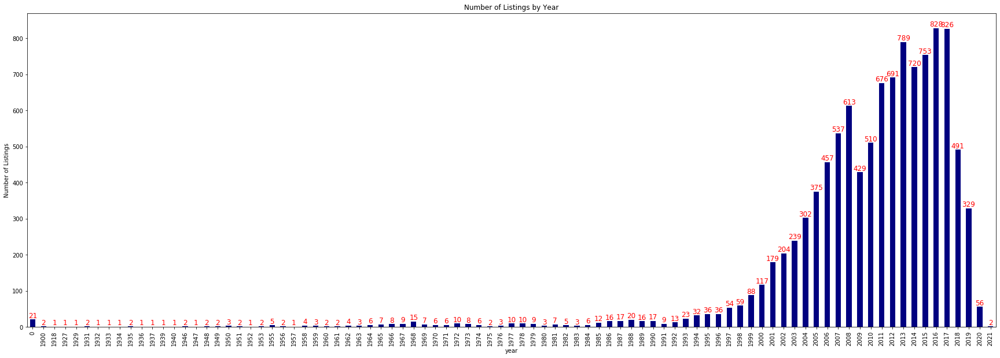

In [18]:
ay= df1.groupby(['year'])['id'].count().plot(kind='bar',label='index',colormap='jet',title="Number of Listings by Year", figsize = [30,10])
ay.set_ylabel("Number of Listings")

for p in ay.patches:
    ay.text(p.get_x() + p.get_width()/2., p.get_height(), '%d' % int(p.get_height()), 
            fontsize=12, color='red', ha='center', va='bottom')

In [19]:
display(df1[df1['year']==2021])

,Unnamed: 0,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state,lat,long
3354,54532,7083766383,janesville,800,2021,Unknown,Janesville,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,wi,42.6683,-89.0025
3535,138606,7090246929,maine,100,2021,Unknown,Any,NaN,NaN,other,NaN,clean,other,NaN,NaN,NaN,NaN,me,43.7340,-70.2625


In [20]:
df_post_1965 = df1[df1['year'] >= 1965]
df_post_1965 = df_post_1965[df_post_1965['year'] < 2021]

In [21]:
len(df_post_1965)

10709

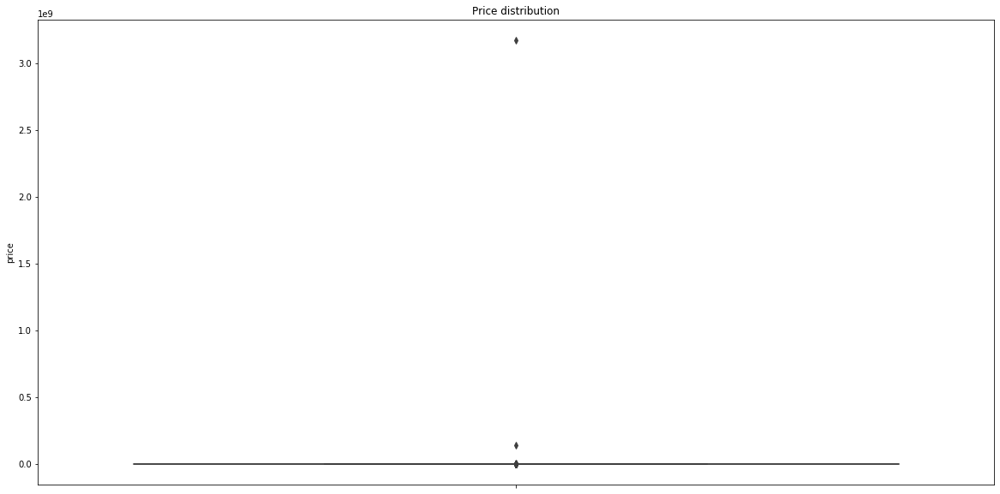

count    1.070900e+04
mean     3.214211e+05
std      3.063860e+07
min      0.000000e+00
25%      4.200000e+03
50%      9.500000e+03
75%      1.770000e+04
max      3.167547e+09
Name: price, dtype: float64

In [22]:
plt.figure(figsize=(20,10))
box_plot = sns.boxplot(y='price', data=df_post_1965, whis = 1.5)
                       #, showfliers = False)
plt.title("Price distribution")
plt.show()
box_plot.figure.tight_layout()
df_post_1965['price'].describe()

In [23]:
display(df_post_1965[df_post_1965['price']>200000])

,Unnamed: 0,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state,lat,long
2218,246546,7085990353,chico,3167547323,2013,volvo,xc60,excellent,NaN,gas,152778.0,clean,automatic,YV4902DZ9D2387750,4wd,SUV,blue,ca,38.7381,-121.2900
5365,31589,7092184862,brownsville,1111111,2012,toyota,NaN,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,tx,25.9504,-97.3217
6243,317043,7091862220,humboldt county,140008000,2006,chevrolet,06 Silverado/99 Tahoe,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,ca,40.7420,-124.1990
9262,374225,7093000659,orange county,475000,2008,chevrolet,silverado,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,ca,33.7059,-117.8450


In [24]:
df_pr_range = df_post_1965[df_post_1965.price <= 200000]

In [25]:
len(df_pr_range)

10705

In [26]:
display(df_pr_range[(df_pr_range['price'] == 0) & ((df_pr_range['odometer'] == 0) | (df_pr_range['odometer'].isnull()))])

,Unnamed: 0,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state,lat,long
24,338568,7086497269,el paso,0,2003,hummer,hummer h2,new,8 cylinders,gas,NaN,clean,automatic,5GRGN230X3H108723,4wd,SUV,white,tx,31.7432,-106.3690
74,226195,7090272566,cincinnati,0,2012,ford,e250 econoline,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,oh,39.3224,-84.5033
108,531864,7080167219,rochester,0,2012,gmc,acadia,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,ny,43.2005,-77.5720
168,136753,7092707269,phoenix,0,2016,toyota,tacoma sr5,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,az,33.5103,-112.0560
179,498552,7081713527,zanesville / cambridge,0,2019,ford,transit,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,oh,39.9274,-82.0041
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10512,235131,7081304703,delaware,0,2009,ford,escape,NaN,NaN,other,NaN,clean,automatic,NaN,NaN,NaN,white,de,39.8857,-75.3082
10533,216260,7092603893,detroit metro,0,2019,rover,🔴100% APPROVAL RATE🔴,new,other,other,NaN,clean,other,NaN,rwd,other,custom,mi,NaN,NaN
10562,191926,7088897903,rochester,0,2013,ford,f-150,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,ny,43.2005,-77.5720
10596,143928,7090720960,san antonio,0,2019,chevrolet,NaN,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,tx,29.5054,-98.6688


In [27]:
df_pr_range1 = df_pr_range.drop(df_pr_range[(df_pr_range['price'] == 0) & ((df_pr_range['odometer'] == 0) | (df_pr_range['odometer'].isnull()))].index, axis=0)

In [28]:
len(df_pr_range1)

10479

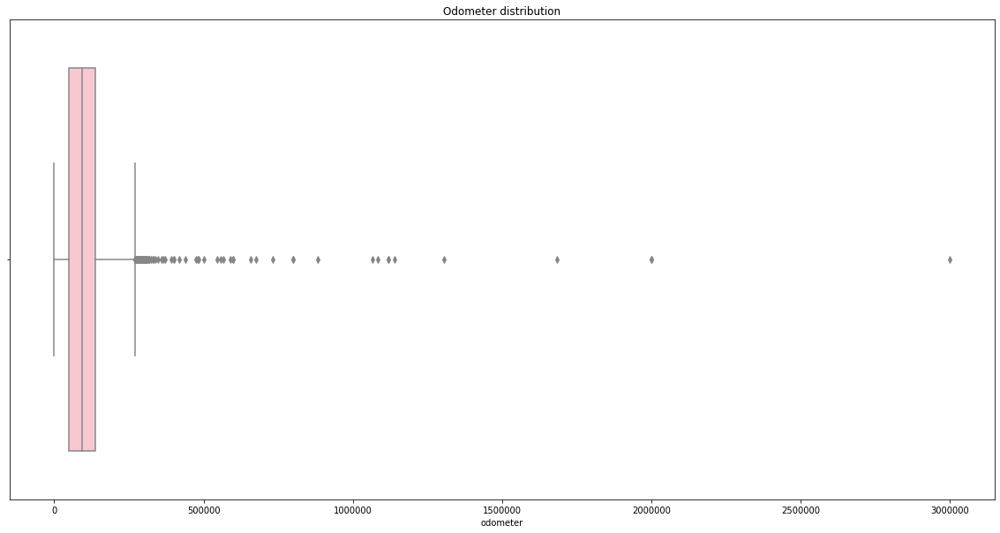

count    8.753000e+03
mean     1.009526e+05
std      8.368505e+04
min      0.000000e+00
25%      4.911800e+04
50%      9.440000e+04
75%      1.374760e+05
max      3.000051e+06
Name: odometer, dtype: float64

In [29]:
plt.figure(figsize=(20,10))
box_plot = sns.boxplot(x='odometer', data=df_pr_range1, whis = 1.5, color = 'pink')
plt.title("Odometer distribution")
plt.show()
box_plot.figure.tight_layout()
df_pr_range1['odometer'].describe()

In [30]:
vc=df_pr_range1[df_pr_range1['odometer'].notnull()]
vc['pr_od_ratio'] = vc['price']/vc['odometer']
initial_filter=copy.deepcopy(vc.groupby(["manufacturer","model","year"]))
second_filter=copy.deepcopy(vc.groupby(["manufacturer","model"]))

odometre_index=list(df_pr_range1[df_pr_range1['odometer'].isnull()].index)
first_filter={}
second_f={}
for k,v in initial_filter:
    first_filter[k]=v["pr_od_ratio"].median()
for k,v in second_filter:
    second_f[k]=v["pr_od_ratio"].median() 
for ind in odometre_index:
    manuf=df_pr_range1.at[ind,"manufacturer"]
    model=df_pr_range1.at[ind,"model"]
    year=df_pr_range1.at[ind,"year"]
    if (manuf,model,year) in first_filter.keys():
        df_pr_range1.at[ind,"odometer"]= df_pr_range1.at[ind,"price"]/first_filter[(manuf,model,year)]
    elif (manuf,model) in second_f.keys():
        df_pr_range1.at[ind,"odometer"]=  df_pr_range1.at[ind,"price"]/second_f[(manuf,model)]

C:\Users\Harsh\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Harsh\anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
C:\Users\Harsh\anaconda3\lib\site-packages\ipykernel_launcher.py:20: RuntimeWarning: divide by zero encountered in true_divide


In [31]:
car = df_pr_range1.drop(df_pr_range1[(df_pr_range1['odometer'] > 320000)].index, axis=0)

In [32]:
interval_range = pd.interval_range(start=0, freq=10000, end=320000)
car['odo_bins'] = pd.cut(car['odometer'], bins=interval_range, labels=[1,2,3])
car['odo_bins'] = car['odo_bins'].astype(str)
car['odo_bins'] = car['odo_bins'].map(lambda x: x.lstrip('(').rstrip(']').replace(',',' to'))

In [33]:
car['state'] = car['state'].str.upper()

In [36]:
def cylinders(row):
     if type(row["cylinders"]) is str:
         cyl = re.findall(r"(\d) cylinders", row["cylinders"])
         if len(cyl) != 0:
             return int(cyl[0])
         else:
             return 999
     else:
         return 999
        
car["cylinders"] = car.apply(cylinders,axis=1)

In [37]:
car['odo_bins_up_range']=car['odo_bins'].map(lambda x: x if x == 'nan' else x.split("to")[1][:-6])
car.drop(car[car['manufacturer']=="Unknown"].index, axis=0, inplace=True)
len(car)

10234

In [38]:
first_filter=copy.deepcopy(car.groupby(["manufacturer","model","year","odo_bins_up_range"]))
second_filter=copy.deepcopy(car.groupby(["manufacturer","model","year"]))
third_filter=copy.deepcopy(car.groupby(["manufacturer","model"]))

In [39]:
id_price_0=list(car[car.price==0].index)
dropped_count=0
model_not_present_count=0
for i in id_price_0:
    manuf=car.at[i,"manufacturer"]
    model=car.at[i,"model"]
    year=car.at[i,"year"]
    odo_bins_up_range=car.at[i,"odo_bins_up_range"]
    if str(model)=='nan':
        model_not_present_count+=1
        car.drop(i,axis=0,inplace=True)
        continue
        
    
    else:    
        
        if len(first_filter.get_group((manuf,model,year,odo_bins_up_range))[first_filter.get_group((manuf,model,year,odo_bins_up_range))["price"]>0])>1:
            price=first_filter.get_group((manuf,model,year,odo_bins_up_range))[first_filter.get_group((manuf,model,year,odo_bins_up_range))["price"]>0]["price"].median()
            car.at[i,"price"]=price   
        elif len(second_filter.get_group((manuf,model,year))[second_filter.get_group((manuf,model,year))["price"]>0])>1:
            price=second_filter.get_group((manuf,model,year))[second_filter.get_group((manuf,model,year))["price"]>0]["price"].median()
            car.at[i,"price"]=price 
        elif len(third_filter.get_group((manuf,model))[third_filter.get_group((manuf,model))["price"]>0])>1:
            price=third_filter.get_group((manuf,model))[third_filter.get_group((manuf,model))["price"]>0]["price"].median()
            car.at[i,"price"]=price 
   
        else:
            car.drop(i,axis=0,inplace=True)
            dropped_count+=1
print("total rows dropped from the dataframe are %d"%(dropped_count+model_not_present_count))
print("total records where model is null and price left unchanged are %d"%(model_not_present_count))

total rows dropped from the dataframe are 160
total records where model is null and price left unchanged are 7


In [40]:
len(car)

10074

In [41]:
car["drive"].fillna('Unknown', inplace=True)
car["type"].fillna('Unknown', inplace=True)
car["paint_color"].fillna('Unknown', inplace=True)
car["condition"].fillna('Unknown', inplace=True)
car["title_status"].fillna('Unknown', inplace=True)
car["transmission"].fillna('Unknown', inplace=True)

In [45]:
currYear = datetime.now()
currYear = currYear.year
car['age']=car['year'].map(lambda x: currYear-x)

# Exploratory Data Analysis

#### Price Distribution

In [49]:
fig = px.histogram(car, x="price", marginal="rug", hover_data=car.columns)
fig.show()

#### Odometer Distribution

In [50]:
fig = px.histogram(car, x="odometer", marginal="rug", hover_data=car.columns)
fig.show()

#### Top 10 Regions with most listings

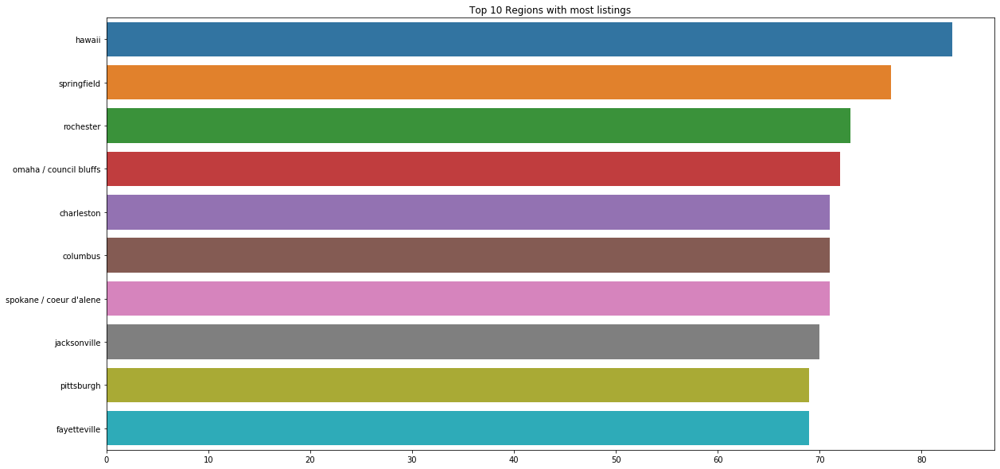

In [51]:
topRegions = car['region'].value_counts().iloc[:10]
plt.figure(figsize=(20,10))
sns.barplot(y=topRegions.index, x=topRegions.values)
plt.title("Top 10 Regions with most listings")
plt.show()

#### Top 10 Brands with most listings

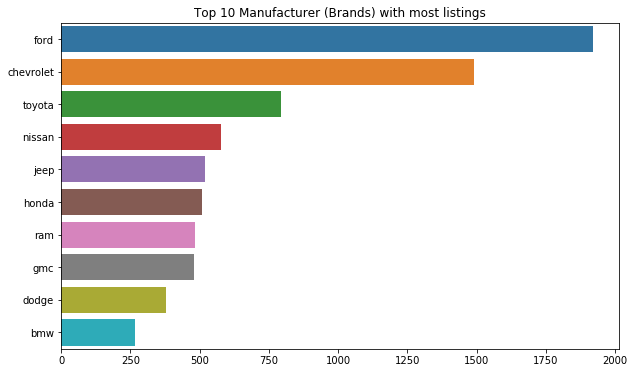

In [52]:
topManufacturer = car['manufacturer'].value_counts().iloc[:10]
plt.figure(figsize=(10,6))
ax = sns.barplot(y=topManufacturer.index, x=topManufacturer.values)
plt.title("Top 10 Manufacturer (Brands) with most listings")
plt.show()

In [53]:
d = {'manufacturer': ['ford', 'chevrolet', 'toyota', 'nissan', 'jeep']}
topBrands = pd.DataFrame(data=d)
result = pd.merge(topBrands, car, how='left', on=['manufacturer'])

In [54]:
fig = px.scatter(result, x='odometer', y='price', color='manufacturer',
              hover_data=['price', 'odometer'], labels={'Price-Odometer Trend'}, size_max=55)
fig.show()

Text(0.5, 1.0, 'Top 10 age of car listings')

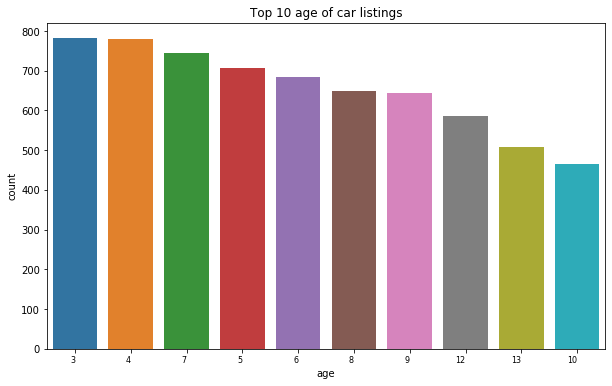

In [55]:
plt.figure(figsize=(10,6))
topYear = car['age'].value_counts().iloc[:10]
topYear = pd.DataFrame({'age' : topYear.index.astype(int), 'count' : topYear.values.astype(int)})
ax = sns.barplot(x='age', y='count', data=topYear, order = topYear['age'])
ax.set_xticklabels(ax.get_xticklabels(), ha="right",fontsize=8)
plt.title("Top 10 age of car listings")

#### Percentage of car listings falling in Odometer range

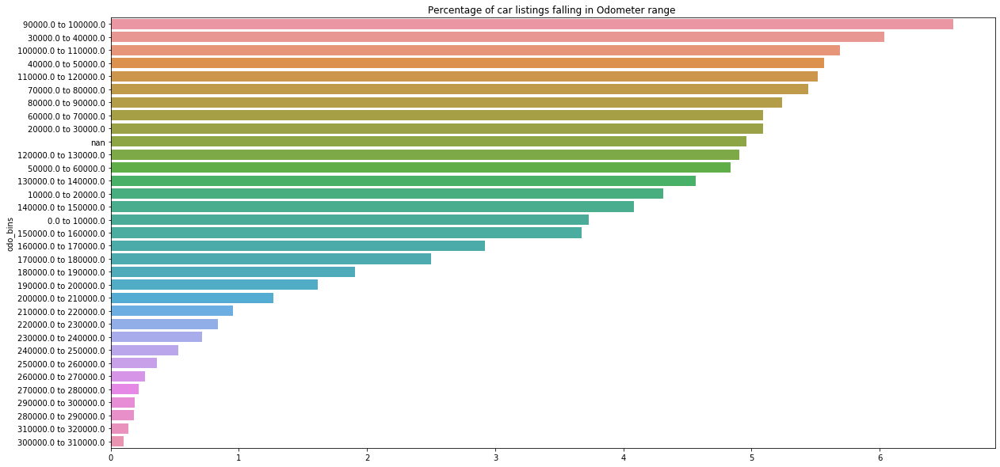

In [56]:
cot = car.groupby(['odo_bins']).id.count().mul(100).sort_values(ascending=False).div(len(car))
plt.figure(figsize=(20,10))
sns.barplot(x=cot.values, y=cot.index)
plt.title("Percentage of car listings falling in Odometer range ")
plt.show()

In [57]:
car.groupby(['manufacturer','model','year']).agg({'price':['mean','count']}).sort_values(('price','count'), ascending=False)[:10]

price      
                                          mean count
manufacturer model          year                    
ford         f-150          2010  12024.916667    24
                            2013  16066.347826    23
                            2011  13881.700000    20
                            2014  18724.150000    20
                            2015  25648.187500    16
chevrolet    silverado 1500 2016  23517.000000    15
ram          1500           2015  21246.533333    15
ford         f-150          2012  15485.266667    15
chevrolet    silverado 1500 2014  19456.714286    14
jeep         wrangler       2008  12553.000000    13

#### Price Plot by Type of Car

Text(0.5, 1, 'Price Plot by Type of Car')

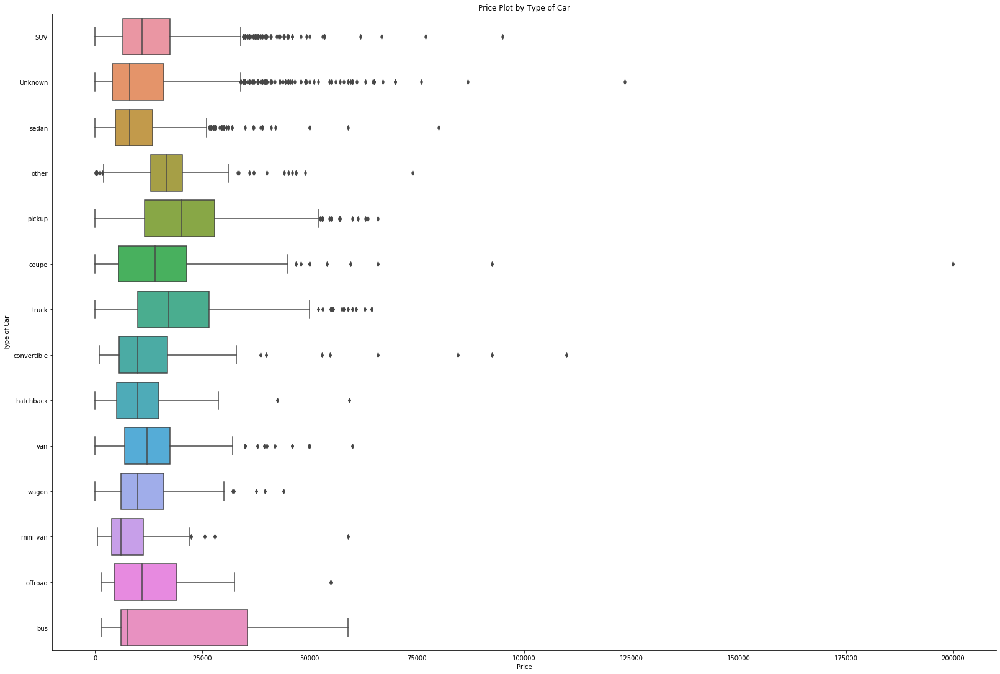

In [58]:
mx = sns.catplot(y='type', x="price", data=car, kind="box",height=15 ,aspect=1.5)
mx.set(xlabel='Price')
mx.set(ylabel= 'Type of Car')
plt.title('Price Plot by Type of Car')

#### Price Plot by Type of Car

Text(0.5, 1, 'Price Plot by Car color')

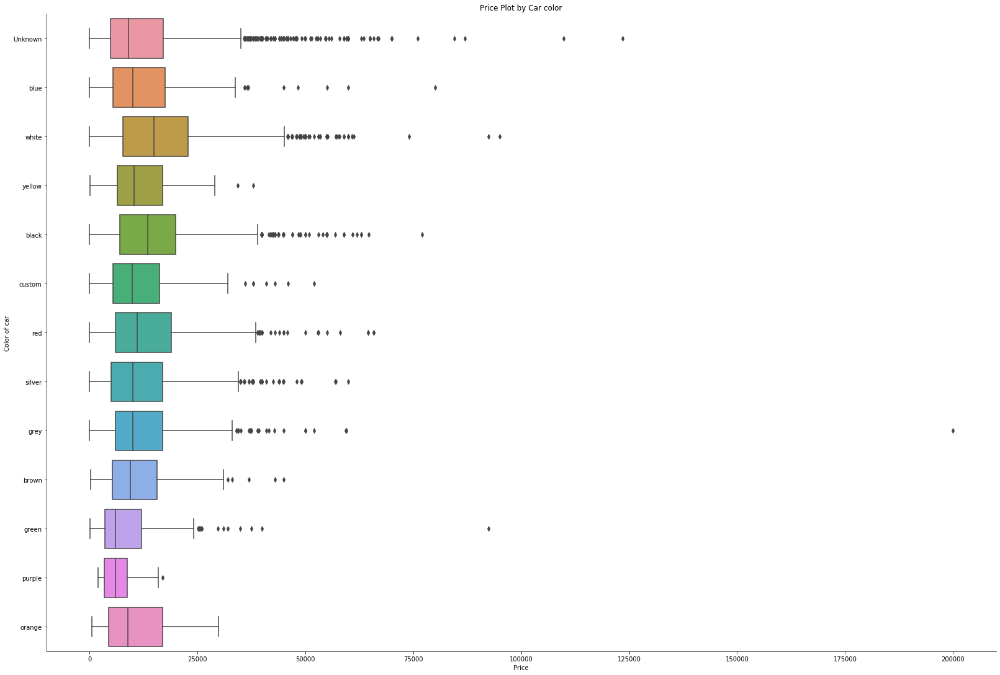

In [59]:
mx = sns.catplot(y='paint_color', x="price", data=car, kind="box",height=15 ,aspect=1.5)
mx.set(xlabel='Price')
mx.set(ylabel= 'Color of car')
plt.title('Price Plot by Car color')

#### Price Plot by Manufacturer

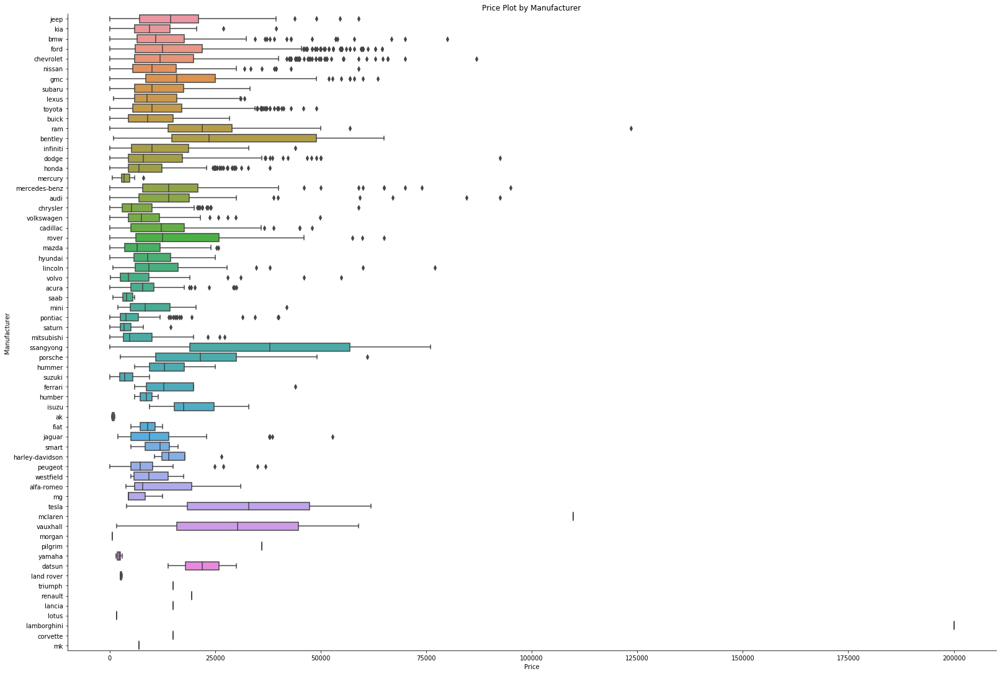

In [60]:
mx = sns.catplot(y="manufacturer", x="price", data=car, kind="box",height=15 ,aspect=1.5)
mx.set(xlabel='Price')
mx.set(ylabel= 'Manufacturer')
plt.title('Price Plot by Manufacturer')
plt.savefig('Price Plot by Manufacturer')

In [61]:
def manufact(i):
    k=car.price[(car.manufacturer==i)].describe().tolist()
    iqr=k[6]-k[4]
    up=k[6]+1.5*iqr
    lb=k[4]-1.5*iqr
    l=(car.price[(car.manufacturer==i)] > up ) | (car.price[(car.manufacturer==i)] < lb )
    return l.sum()

In [62]:
un_manuf = car.manufacturer.unique()
outlier=[manufact(str(j)) for j in un_manuf]
out_df=pd.DataFrame()
out_df['manufacturer']=np.array(un_manuf)
out_df['Outliers']=np.array(outlier)

out_df

,manufacturer,Outliers
0,jeep,4
1,kia,2
2,bmw,16
3,ford,46
4,chevrolet,43
...,...,...
59,lancia,0
60,lotus,0
61,lamborghini,0
62,corvette,0


#### Price plot by State

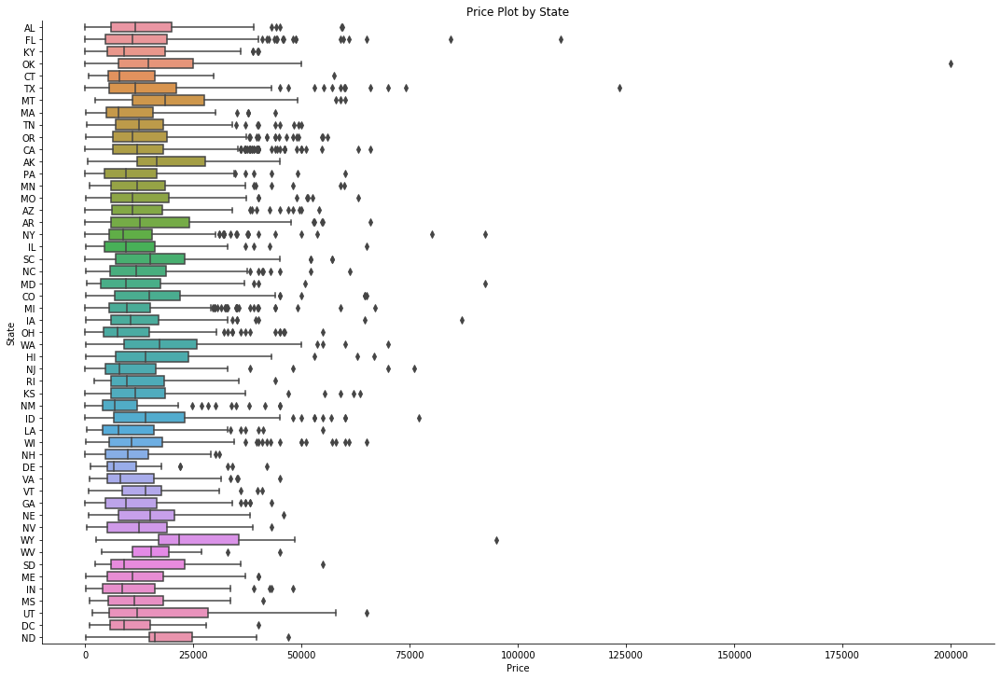

In [63]:
mx = sns.catplot(y="state", x="price", data=car, kind="box",height=10 ,aspect=1.5)
mx.set(xlabel='Price')
mx.set(ylabel= 'State')
plt.title('Price Plot by State')
plt.savefig('Price Plot by State')

#### Odometer Plot by Manufacturer

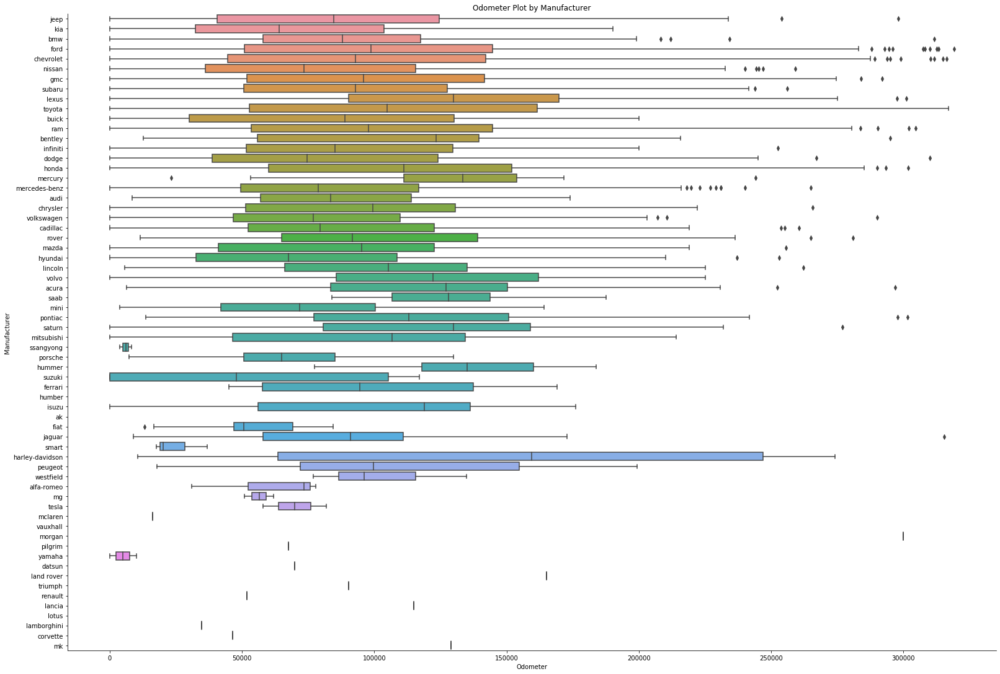

In [64]:
mx = sns.catplot(y="manufacturer", x="odometer", data=car, kind="box",height=15 ,aspect=1.5)
mx.set(xlabel='Odometer')
mx.set(ylabel= 'Manufacturer')
plt.title('Odometer Plot by Manufacturer')
plt.savefig('Odometer Plot by Manufacturer')

#### Mean Price by State

In [65]:
df_mean_price_by_state = round(car.groupby(['state'])['price'].mean().reset_index(name = 'Average Price'), 0)

In [66]:
fig = px.choropleth(df_mean_price_by_state, locationmode="USA-states", locations='state', color='Average Price',
                           color_continuous_scale="Viridis",
                           range_color=(8000, 20000),
                           scope="usa"
                          )
fig.show()

#### Price vs Miles Driven (Odometer)

In [67]:
fig = px.scatter(car, x='odometer', y='price', 
             hover_data=['price', 'odometer'], labels={'Price-Odometer Trend'}, size_max=55)
fig.show()

#### Price vs Miles Driven by Transmission

In [68]:
fig = px.scatter(car, x='odometer', y='price', color = 'transmission',
             hover_data=['price', 'odometer'], labels={'Price-Odometer Trend'}, size_max=55)
fig.show()



#### Mean price by Age of car

In [69]:
age_mean_price = round(car.groupby(by='age')['price'].mean().reset_index(name="mean price"), 0)

In [70]:
fig = px.scatter(age_mean_price, x='age', y='mean price', 
             hover_data=['mean price', 'age'], labels={'Price-Age Trend'})
fig.show()

#### Price Plot by Year

Text(0, 0.5, 'Price')

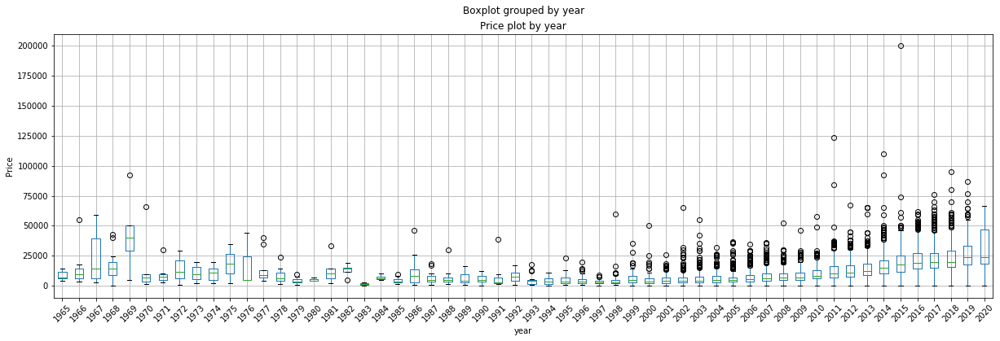

In [71]:
car.boxplot(column='price',by='year',fontsize=10,figsize=(20,6),rot=45)
plt.title('Price plot by year')
plt.ylabel('Price')

#### Price Plot by Fuel type

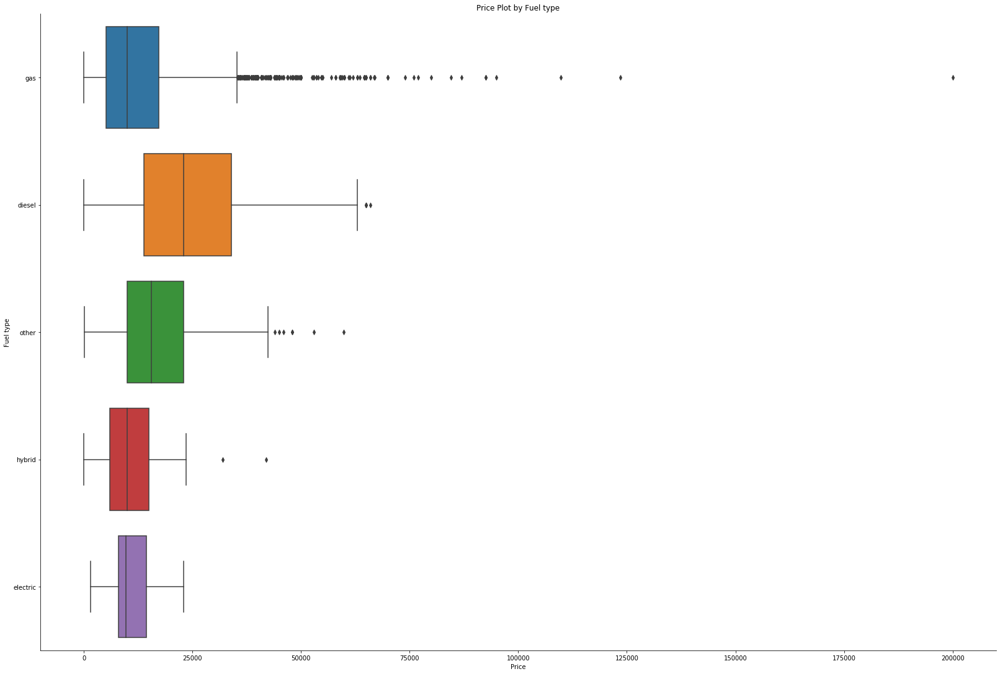

In [72]:
mx = sns.catplot(y="fuel", x="price", data=car, kind="box",height=15 ,aspect=1.5)
mx.set(xlabel='Price')
mx.set(ylabel= 'Fuel type')
plt.title('Price Plot by Fuel type')
plt.savefig('Price Plot by Fuel type')

#### Odometer plot by Fuel type

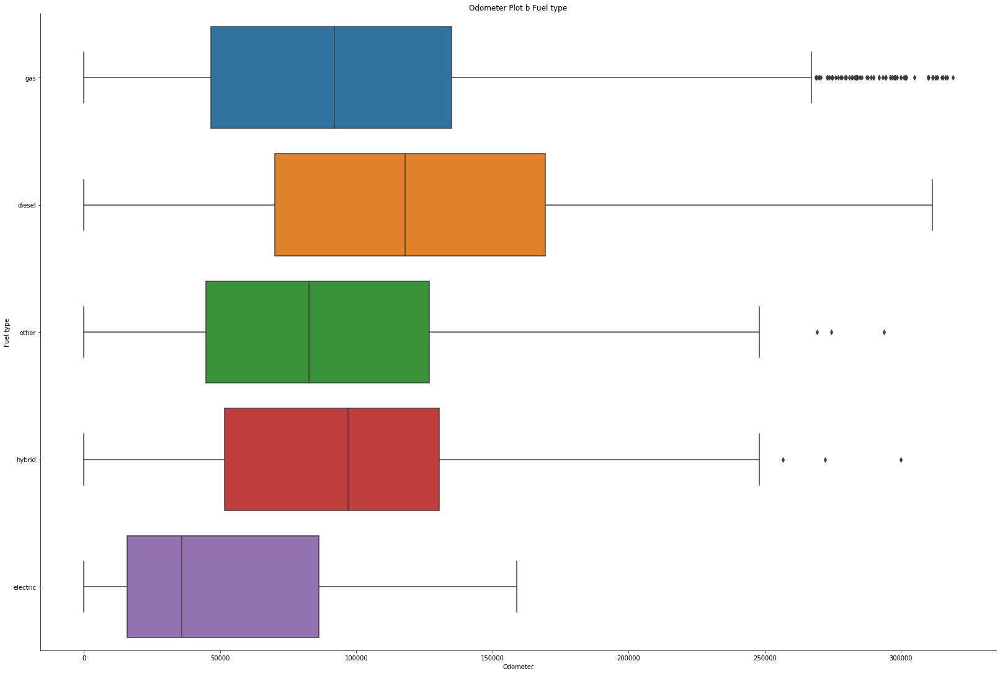

In [73]:
mx = sns.catplot(y="fuel", x="odometer", data=car, kind="box",height=15 ,aspect=1.5)
mx.set(xlabel='Odometer')
mx.set(ylabel= 'Fuel type')
plt.title('Odometer Plot b Fuel type')
plt.savefig('Odometer Plot by Fuel type')

#### Manual vs Auto Transmission Listings by State

In [74]:
manual=car[car.transmission=='manual']
auto=car[car.transmission=='automatic']
man_count = manual.groupby(by=['state',])['state'].count().reset_index(name="count")
auto_count = auto.groupby(by='state')['state'].count().reset_index(name="count")

In [80]:
fig = go.Figure(data=[
    go.Bar(name='Automatic', x=auto_count['state'], y=auto_count['count'], text = auto_count['count'], textposition='auto'),
    go.Bar(name='Manual', x=man_count['state'], y=man_count['count'], text=man_count['count'], textposition='auto')
])
fig.update_layout(barmode='stack')
fig.show()

#### Average Price by condition and transmission category

In [81]:
cond_tran_price = car.groupby(by=['condition', 'transmission'])['price'].mean().reset_index(name="mean price")

In [82]:
cond_tran_price = cond_tran_price.pivot("condition", "transmission", "mean price")

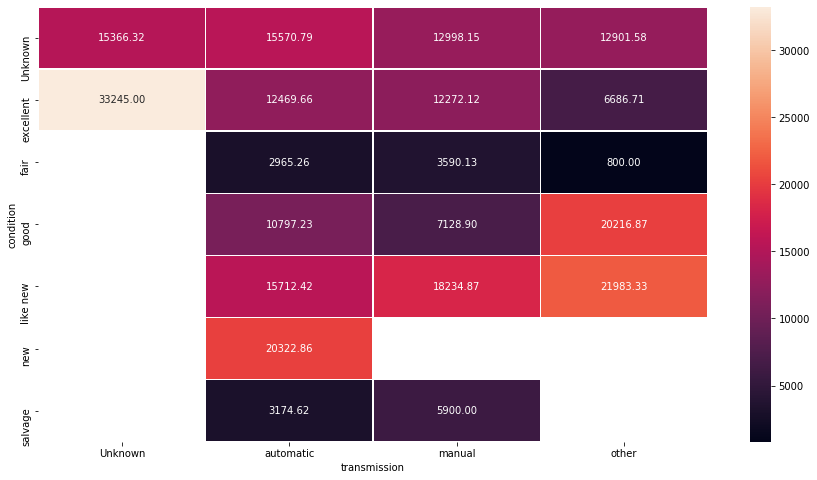

In [83]:
f, ax = plt.subplots(figsize=(15, 8))
sns.heatmap(cond_tran_price, annot=True, fmt=".2f", linewidths=.5, ax=ax)